In [37]:
# Librerías necesarias
import cv2
from matplotlib import pyplot as plt
import numpy as np
import math
from scipy import stats as st
from os.path import exists # Verifica la existencia de archivos

In [38]:
# Funciones auxiliares
def posMax(Vector):
    ''' 
    Calcula la posición del máximo componete del Vector
    Vector: nx1 vector para hallar el máximo
    '''
    return np.where(Vector == np.amax(Vector))[0][0]

def eliminacionColumna(Matriz,nEliminar):
    '''
    Elimina la columna  nEliminar de un Matriz
    '''
    try:
        return np.delete(Matriz, nEliminar, 1)
    except np.AxisError: 
        return np.delete(Matriz, nEliminar, -1)

def auxUltimaPosicionMayorComponenteVectoresPropios(posicionCaractaristicas,posicionCaractaristicasMayorCompoenteVectorPropio,eigVec,posEigVec,n_caracteristicas):
    

    if len(posicionCaractaristicasMayorCompoenteVectorPropio)!=0:

        # Se eliminan las columnas del vector de posición que ya han tenido el mayor
        # Componente de los vectores propios
        # print(posicionCaractaristicasMayorCompoenteVectorPropio)
        PosicionCaractaristicasEvaluar=eliminacionColumna(posicionCaractaristicas,posicionCaractaristicasMayorCompoenteVectorPropio) 

    else:
        PosicionCaractaristicasEvaluar=posicionCaractaristicas

    # Es el condicional para tenerminar la función recursiva
    # evalua que se hayan analizado n-1 posiciones de los vectores propios
    if (len(posicionCaractaristicasMayorCompoenteVectorPropio)+1)==n_caracteristicas:
        return  PosicionCaractaristicasEvaluar    

    # Toma solo los componentes que no han sido catalogados como máximos
    eigVecEvaluar=np.take(eigVec[posEigVec],PosicionCaractaristicasEvaluar)
    
    # Se toma el valor de la posición del componente máximo
    n_max=PosicionCaractaristicasEvaluar[posMax(eigVecEvaluar)]
    
    # Se agrega la nueva posición máxima
    posicionCaractaristicasMayorCompoenteVectorPropio=np.concatenate((posicionCaractaristicasMayorCompoenteVectorPropio, n_max),axis=None )
    
    
    return auxUltimaPosicionMayorComponenteVectoresPropios(posicionCaractaristicas,posicionCaractaristicasMayorCompoenteVectorPropio,eigVec,posEigVec+1,n_caracteristicas)

def ultimaPosicionMayorComponenteVectoresPropios(eigVec):
    ''' 
    Calcula el último máximo de cada fila de un vector sin considerar los anteriores
    eigVec : Matriz de valores propios
    '''

    return auxUltimaPosicionMayorComponenteVectoresPropios(np.arange(eigVec.shape[0]),np.array([],dtype=int),eigVec,0,eigVec.shape[0])

def auxEliminacionCaracteristicas(caracteristicasEstandarizadas,nombre_caracteristicas,porcentajeMaximoVariabilidad,esPrimeraVez,sumLambdaInicial,porcentajeVariabilidadFinal):

    # [2]
   
    
    covM = np.cov(caracteristicasEstandarizadas.transpose(), dtype=np.double)
    eigVal, eigVec = np.linalg.eig(covM)

    # algunos valores dan con números imaginarios entonces se pasa la parte real
    eigVal=np.real(eigVal)
    eigVec=np.real(eigVec)
    
    # print(f'Tamaño vectores propios {eigVec.shape[0]}')
    if esPrimeraVez:
        sumLambdaInicial= np.absolute(np.sum(eigVal)) 
        esPrimeraVez=False


    # print(f'{eigVec.shape[0]}')
    nCaracteristicaEliminar=ultimaPosicionMayorComponenteVectoresPropios(eigVec)
    
    #print(f'n eliminar {nCaracteristicaEliminar}')

    # Se elimina la característica y el nombre de la característica
    auxCaracteristicasEstandarizadas=eliminacionColumna(caracteristicasEstandarizadas,nCaracteristicaEliminar[0])
    auxNombre_caracteristicas=eliminacionColumna(nombre_caracteristicas,nCaracteristicaEliminar[0])

    # Se encuentra de nuevo los valores y vectores propios de las características
    covM = np.cov(auxCaracteristicasEstandarizadas.transpose(), dtype=np.double)
    eigValN, eigVecN = np.linalg.eig(covM)

    # algunos valores dan con números imaginarios entonces se pasa la parte real
    eigValN=np.real(eigValN)
    eigVecN=np.real(eigVecN)

    # Se calcula de nuevo la suma de los valores propios
    sumLambdaFinal=np.absolute(np.sum(eigValN))
    
    
    print(f'La variación es: {sumLambdaFinal*100/sumLambdaInicial} %')

   
    
    # Cuando la variabilidad es menor o igual a la máxima deseada se detiene el proceso 
    if (sumLambdaFinal*100)<=(porcentajeMaximoVariabilidad*sumLambdaInicial):
        if porcentajeVariabilidadFinal==0:
            porcentajeVariabilidadFinal=100

        return [caracteristicasEstandarizadas,nombre_caracteristicas,porcentajeVariabilidadFinal] 
    
    porcentajeVariabilidadFinal=sumLambdaFinal*100/sumLambdaInicial


    return auxEliminacionCaracteristicas(auxCaracteristicasEstandarizadas,\
        auxNombre_caracteristicas,porcentajeMaximoVariabilidad,esPrimeraVez,\
        sumLambdaInicial,porcentajeVariabilidadFinal)

# Funciones principales
def extraccionContornos(imagenes):


    img_gray_blur = [] # Imagen en escala de grises
    img_threshold=[] # Lista de imágenes umbralizadas
    lisContornos = [] # Lista de contornos
    img_contornos_polylines=[]
    img_contornos_drawContours=[]
    

    for i in range(len(imagenes)):
   
        # Conversión a escala de grises
        img_gray_blur.append(cv2.cvtColor(imagenes[i], cv2.COLOR_RGB2GRAY)) 

        # Umbralización con threshold
        img_thr_threshold= cv2.threshold(img_gray_blur[i],10,255,0)[1]
        
        img_threshold.append(img_thr_threshold)

       

        # Se hallan los contornos 
        contours=cv2.findContours(\
            img_threshold[i],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)[0]
        
        areas=np.array([],float)


        for contorno in contours:        
                areas=np.append(areas,cv2.contourArea(contorno))

        posicionMaximaArea=posMax(areas)

        lisContornos.append(contours[posicionMaximaArea]) 
        
        
        img_contornos_polylines.append(imagenes[i].copy())
        img_contornos_drawContours.append(imagenes[i].copy())

        #Dibuja contornos 
        cv2.polylines(img_contornos_polylines[i], lisContornos[i], 1, color=(0, 0, 255), thickness=2, lineType=cv2.LINE_AA)

        cv2.drawContours(img_contornos_drawContours[i], contours=lisContornos[i],\
            contourIdx=-1, color=(0, 0, 255), thickness=2, lineType=cv2.LINE_AA)
    
    
    return [img_gray_blur,lisContornos,img_contornos_polylines,img_contornos_drawContours]

def extraccionCaracteristicas(imagenes,imagenes_gray,lisContornos):

    n_imagenes=len(imagenes)
    n_caracteristicas=1 # Registra el número total de características

    caracteristicas=[] # Caracerísticas de las n imágenes
    


    for j in range(n_imagenes):

        ## Sacar vectores sin color negro

        n=imagenes[j].shape[0]
        m=imagenes[j].shape[1]
 

        # Extracción de RGB
        aux_new_imagenes_gray=imagenes_gray[j].copy()

        imagenes_R=imagenes[j][:,:,0]
        imagenes_G=imagenes[j][:,:,1]
        imagenes_B=imagenes[j][:,:,2]

        # Se pone en una sola columna la matriz nxm
        imagenes_R.shape=(n*m)
        imagenes_G.shape=(n*m)
        imagenes_B.shape=(n*m)
        aux_new_imagenes_gray.shape=(n*m)

        # print(f'Vector R inicial {imagenes_R.shape}')
        # print(f'Vector G inicial {imagenes_G.shape}')
        # print(f'Vector B inicial {imagenes_B.shape}')
        # print(f'Vector gris inicial {aux_new_imagenes_gray.shape}')

        # Vectores R, G, B y Grises sin el color negro

        imagenes_R_sinNegro=[]
        imagenes_G_sinNegro=[]
        imagenes_B_sinNegro=[]
        new_imagenes_gray_sinNegro=[]

        for i in range(n*m):
            if imagenes_R[i]!=0:
                imagenes_R_sinNegro.append(imagenes_R[i])
            if imagenes_G[i]!=0:
                imagenes_G_sinNegro.append(imagenes_G[i])
            if imagenes_B[i]!=0:
                imagenes_B_sinNegro.append(imagenes_B[i])   
            if aux_new_imagenes_gray[i]!=0:
                new_imagenes_gray_sinNegro.append(aux_new_imagenes_gray[i])
            

        # print(f'Vector R final {len(imagenes_R_sinNegro)}')
        # print(f'Vector G final {len(imagenes_G_sinNegro)}')
        # print(f'Vector B final {len(imagenes_B_sinNegro)}')
        # print(f'Vector gris final {len(new_imagenes_gray_sinNegro)}')

        # Se reinicia el vector de características y momentos de cada imagen
        aux_caracteristicas=[]
      

        # Extracción de moda en RGB y grises
        aux_caracteristicas.append(st.mode(imagenes_R_sinNegro)[0][0])
        aux_caracteristicas.append(st.mode(imagenes_G_sinNegro)[0][0])
        aux_caracteristicas.append(st.mode(imagenes_B_sinNegro)[0][0])
        aux_caracteristicas.append(st.mode(new_imagenes_gray_sinNegro)[0][0])


        # Extracción de media en RGB y grises
        aux_caracteristicas.append(np.mean(imagenes_R_sinNegro))
        aux_caracteristicas.append(np.mean(imagenes_G_sinNegro))
        aux_caracteristicas.append(np.mean(imagenes_B_sinNegro))
        aux_caracteristicas.append(np.mean(new_imagenes_gray_sinNegro))



        # Extracción de mínimo en RGB y grises
        aux_caracteristicas.append(np.amin(imagenes_R_sinNegro))
        aux_caracteristicas.append(np.amin(imagenes_G_sinNegro))
        aux_caracteristicas.append(np.amin(imagenes_B_sinNegro))
        aux_caracteristicas.append(np.amin(new_imagenes_gray_sinNegro))

        # Extracción de máximo en RGB y grises
        aux_caracteristicas.append(np.amax(imagenes_R_sinNegro))
        aux_caracteristicas.append(np.amax(imagenes_G_sinNegro))
        aux_caracteristicas.append(np.amax(imagenes_B_sinNegro))
        aux_caracteristicas.append(np.amax(new_imagenes_gray_sinNegro))

        #Momentos
        momentos=cv2.moments(lisContornos[j])

        #MomentosHU
        aux_caracteristicas.append(cv2.HuMoments(momentos)[0][0])
        aux_caracteristicas.append(cv2.HuMoments(momentos)[1][0])
        aux_caracteristicas.append(cv2.HuMoments(momentos)[2][0])
        aux_caracteristicas.append(cv2.HuMoments(momentos)[3][0])
        aux_caracteristicas.append(cv2.HuMoments(momentos)[4][0])
        aux_caracteristicas.append(cv2.HuMoments(momentos)[5][0])
        aux_caracteristicas.append(cv2.HuMoments(momentos)[6][0])
        

        # Redondez [1]
        try:
            aux_caracteristicas.append((4*math.pi*cv2.contourArea(lisContornos[j]))/(cv2.arcLength(lisContornos[j],True))**2)
        except ZeroDivisionError:
            aux_caracteristicas.append(0)


        # Relación entre Eje mayor y menor
        

        # Se va aumentando el vector de características totales
        caracteristicas+=aux_caracteristicas

    # Se contabilizan el númeto de características    
    n_caracteristicas=len(aux_caracteristicas)
    aux_caracteristicas=[]
    # Se convierte de lista a array 
    caracteristicas=np.array(caracteristicas)


    # Se convierte el array a tamaño n_imagenesxn_caracteristicas 
    caracteristicas.shape=(n_imagenes,n_caracteristicas)
    print(f'Forma características: {caracteristicas.shape}')

    return caracteristicas

def estandarizacionCaracteristicas(caracteristicas,atributos_caracteristicas):
    Xl_min=np.float64(atributos_caracteristicas[:,1].T)
    Xl_max=np.float64(atributos_caracteristicas[:,2].T)
    nombre_caracteristicas=atributos_caracteristicas[:,0].T

    # Se aplica la estandarización
    caracteristicasEstandarizadas=np.zeros(caracteristicas.shape)
    for i in range(caracteristicas.shape[0]):
        caracteristicasEstandarizadas[i]=(caracteristicas[i]-Xl_min)/(Xl_max-Xl_min)

    return [caracteristicasEstandarizadas,nombre_caracteristicas]

def analisisPCA(caracteristicasEstandarizadas,nombre_caracteristicas,porcentajeMaximoVariabilidad):
    '''
        caracteristicasEstandarizadas: caracaterísticas estandarizadas [n imágenes, n características]
        nombre_caracteristicas: Nombre de las características tamaño [1,n características]
        porcentajeMaximoVariabilidad: Máximo porcentaje de variación permitida
    '''
    return auxEliminacionCaracteristicas(caracteristicasEstandarizadas,nombre_caracteristicas,porcentajeMaximoVariabilidad,True,0,0)


In [48]:
# Importación de imágenes

ruta='../figs/imagenesSegmentadasAutomaticamente/'
listaImagenesProcesadas=np.array([])

# Importación de monilia
n_imag_monilia=72
# n_imag_monilia=5
imag_monilia=[]

# Importacion de Phytophthora 

n_imag_fito=64
# n_imag_fito=5
imag_fito=[]

# Importación de cacao saludable

n_imag_healty=53
# n_imag_healty=5
imag_healty=[]

for i in range(n_imag_monilia):
    if exists(f'{ruta}Monilia/Monilia{i}.jpg'):
        listaImagenesProcesadas=np.append(listaImagenesProcesadas,'monilia')
        imag_aux = cv2.imread(f'{ruta}Monilia/Monilia{i}.jpg')
        imag_aux=cv2.cvtColor(imag_aux,cv2.COLOR_BGR2RGB)
        imag_monilia.append(imag_aux)

for i in range(n_imag_fito):
    if exists(f'{ruta}Fito/Fito{i}.jpg'):
        listaImagenesProcesadas=np.append(listaImagenesProcesadas,'fito')
        imag_aux = cv2.imread(f'{ruta}Fito/Fito{i}.jpg')
        imag_aux=cv2.cvtColor(imag_aux,cv2.COLOR_BGR2RGB)
        imag_fito.append(imag_aux)


for i in range(n_imag_healty):
    if exists(f'{ruta}Sana/Sana{i}.jpg'):
        listaImagenesProcesadas=np.append(listaImagenesProcesadas,'saludable')
        imag_aux = cv2.imread(f'{ruta}Sana/Sana{i}.jpg')
        imag_aux=cv2.cvtColor(imag_aux,cv2.COLOR_BGR2RGB)
        imag_healty.append(imag_aux)

imagenes=imag_monilia+imag_fito+imag_healty

print(f'Imágenes importadas de monilia: {len(imag_monilia)}')
print(f'Imágenes importadas de fito: {len(imag_fito)}')
print(f'Imágenes importadas sanas: {len(imag_healty)}')


Imágenes importadas de monilia: 54
Imágenes importadas de fito: 45
Imágenes importadas sanas: 37


In [40]:
# Extracción de contornos
img_gray_blur,lisContornos,img_contornos_polylines,img_contornos_drawContours=extraccionContornos(imagenes)

In [41]:
# Extracción de características
caracteristicas=extraccionCaracteristicas(imagenes,img_gray_blur,lisContornos)


Forma características: (136, 24)


In [42]:
# Normalización características

atributos_caracteristicas=np.array([
['Moda R',0,255],
['Moda G',0,255],
['Moda B',0,255],
['Moda Gris',0,255],
['Media R',0,255],
['Media G',0,255],
['Media B',0,255],
['Media Gris',0,255],
['mínimo R',0,255],
['mínimo G',0,255],
['mínimo B',0,255],
['mínimo Gris',0,255],
['máximo R',0,255],
['máximo G',0,255],
['máximo B',0,255],
['máximo Gris',0,255],
['Momento HU 1',np.amin(caracteristicas[:,16]),np.amax(caracteristicas[:,16])],
['Momento HU 2',np.amin(caracteristicas[:,17]),np.amax(caracteristicas[:,17])],
['Momento HU 3',np.amin(caracteristicas[:,18]),np.amax(caracteristicas[:,18])],
['Momento HU 4',np.amin(caracteristicas[:,19]),np.amax(caracteristicas[:,19])],
['Momento HU 5',np.amin(caracteristicas[:,20]),np.amax(caracteristicas[:,20])],
['Momento HU 6',np.amin(caracteristicas[:,21]),np.amax(caracteristicas[:,21])], 
['Momento HU 7',np.amin(caracteristicas[:,22]),np.amax(caracteristicas[:,22])],
['Redondez',0,1]
])

caracteristicasEstandarizadas,nombre_caracteristicas=estandarizacionCaracteristicas(caracteristicas,atributos_caracteristicas)

In [43]:
# Análisis PCA
porcentajeMaximoVariabilidad=95
caracteristicasNormalizadasPCA,nombreCaracteristicasNormalizadasPCA,porcentajeVariabilidadFinalPCA=analisisPCA(caracteristicasEstandarizadas,nombre_caracteristicas,porcentajeMaximoVariabilidad)

La variación es: 90.65795226373167 %


In [44]:
# Comprobación
covM = np.cov(caracteristicasEstandarizadas.transpose(), dtype=np.double)
eigVal, eigVec = np.linalg.eig(covM)

# algunos valores dan con números imaginarios entonces se pasa la parte real
eigVal=np.real(eigVal)
eigVec=np.real(eigVec)

sumLambdaInicial=np.sum(eigVal)
posicionesNombreCaracteristicasNormalizadasPCA=np.array([],dtype=int)


# Se localizan las posiciones de las características finales del PCA
for i in range(len(nombreCaracteristicasNormalizadasPCA)):
    
    n=np.where(nombre_caracteristicas == nombreCaracteristicasNormalizadasPCA[i])[0][0]
    posicionesNombreCaracteristicasNormalizadasPCA=np.append(posicionesNombreCaracteristicasNormalizadasPCA,n)


# Se toman las caractarísticas de las posiciones del análisis PCA
auxCaracteristicasEstandarizadas=np.take(caracteristicasEstandarizadas,posicionesNombreCaracteristicasNormalizadasPCA,1)
auxNombre_caracteristicas=np.take(nombre_caracteristicas,posicionesNombreCaracteristicasNormalizadasPCA)

# Se encuentra de nuevo los valores y vectores propios de las características
covM = np.cov(auxCaracteristicasEstandarizadas.transpose(), dtype=np.double)
eigValN, eigVecN = np.linalg.eig(covM)

# algunos valores dan con números imaginarios entonces se pasa la parte real
eigValN=np.real(eigValN)
eigVecN=np.real(eigVecN)

# Se calcula de nuevo la suma de los valores propios
sumLambdaFinal=np.absolute(np.sum(eigValN))
porcentajeVariabilidadComprobacion=sumLambdaFinal*100/sumLambdaInicial

print(f'La variación es: {porcentajeVariabilidadComprobacion} %')

if porcentajeVariabilidadFinalPCA==porcentajeVariabilidadComprobacion and np.all(auxCaracteristicasEstandarizadas==caracteristicasNormalizadasPCA) :
    print('Comprobado')
    print(f'Características eliminadas\n{eliminacionColumna(nombre_caracteristicas,posicionesNombreCaracteristicasNormalizadasPCA)}\n')
    print(f'Características finales\n{nombreCaracteristicasNormalizadasPCA}')
else:
     print('Por favor revice')


La variación es: 100.0 %
Comprobado
Características eliminadas
[]

Características finales
['Moda R' 'Moda G' 'Moda B' 'Moda Gris' 'Media R' 'Media G' 'Media B'
 'Media Gris' 'mínimo R' 'mínimo G' 'mínimo B' 'mínimo Gris' 'máximo R'
 'máximo G' 'máximo B' 'máximo Gris' 'Momento HU 1' 'Momento HU 2'
 'Momento HU 3' 'Momento HU 4' 'Momento HU 5' 'Momento HU 6'
 'Momento HU 7' 'Redondez']


In [53]:
# Guardar datos
np.save('../data/caracteristicasNormalizadasPCA.npy', caracteristicasNormalizadasPCA)
np.save('../data/nombreCaracteristicasNormalizadasPCA.npy', nombreCaracteristicasNormalizadasPCA)
np.save('../data/listaImagenesProcesadas.npy', listaImagenesProcesadas)

nombreCaracteristicasNormalizadasPCA.shape


(24,)

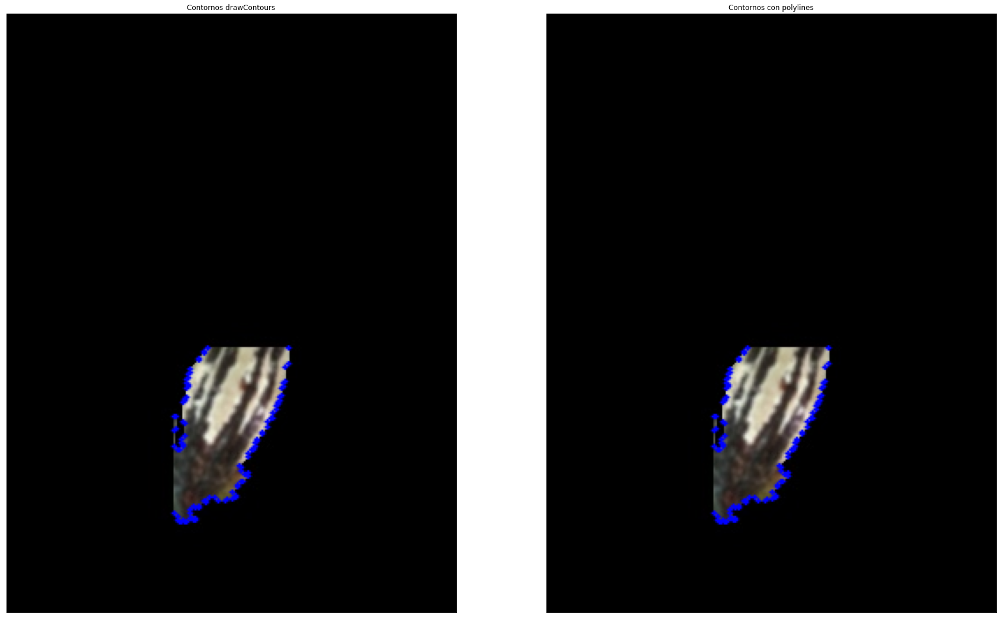

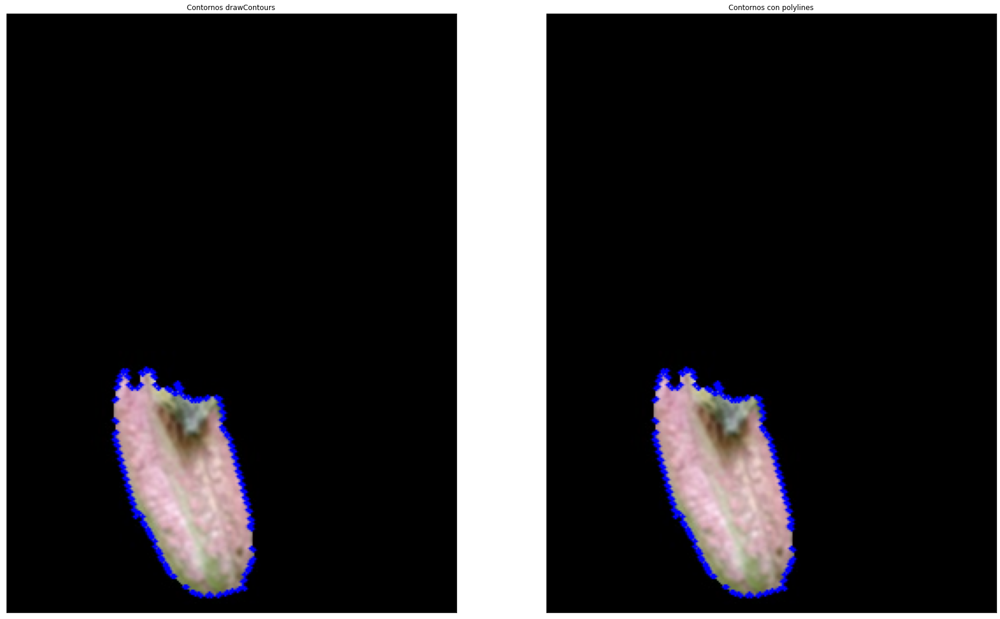

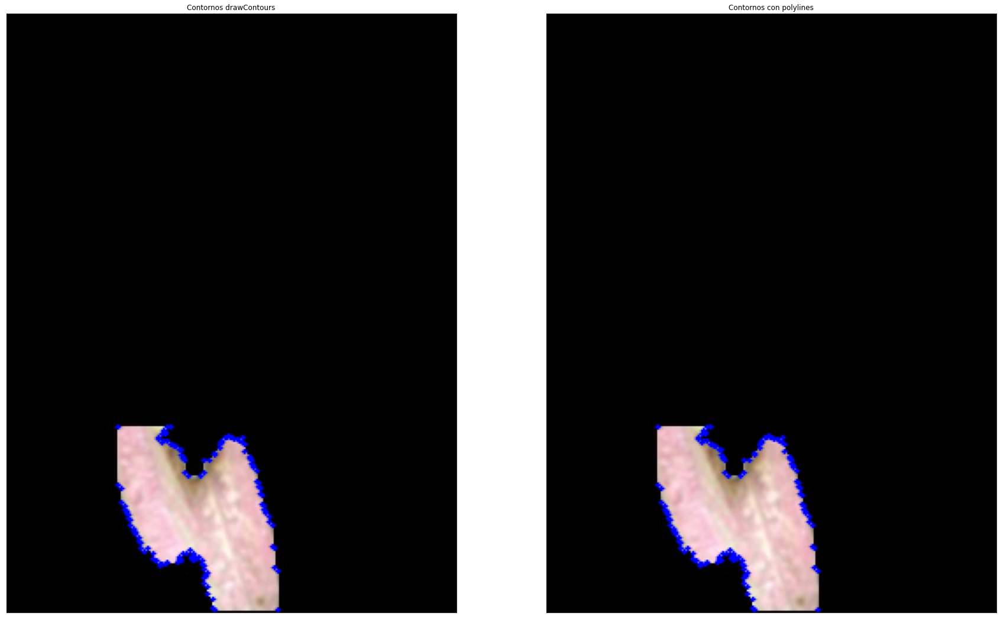

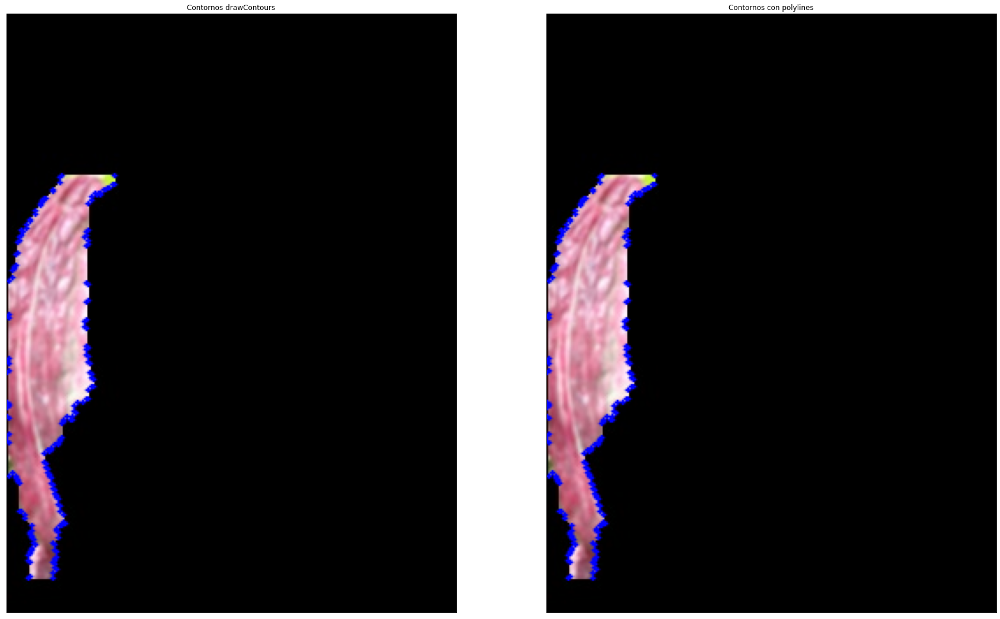

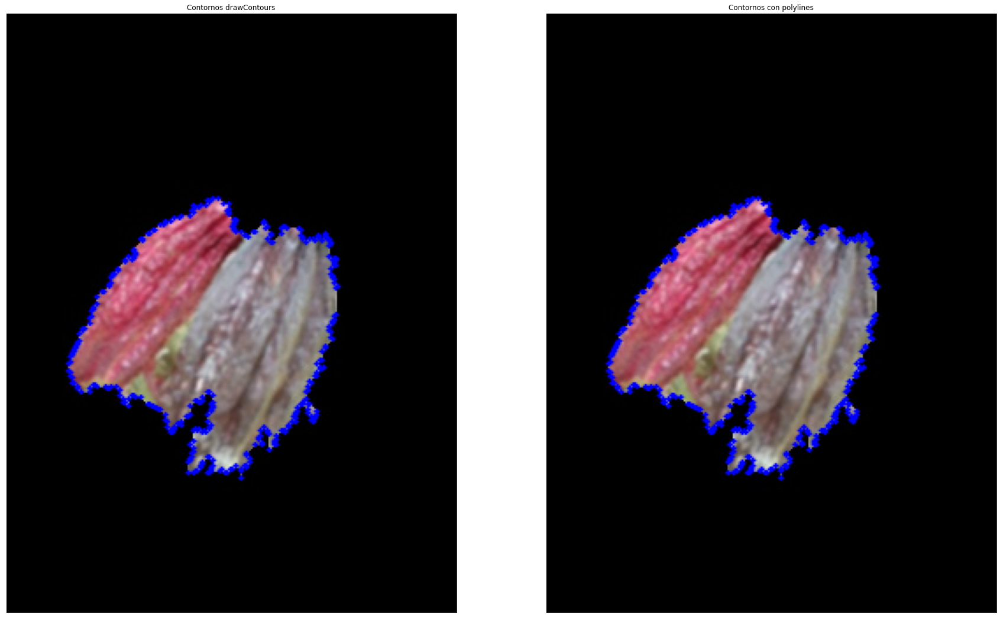

...

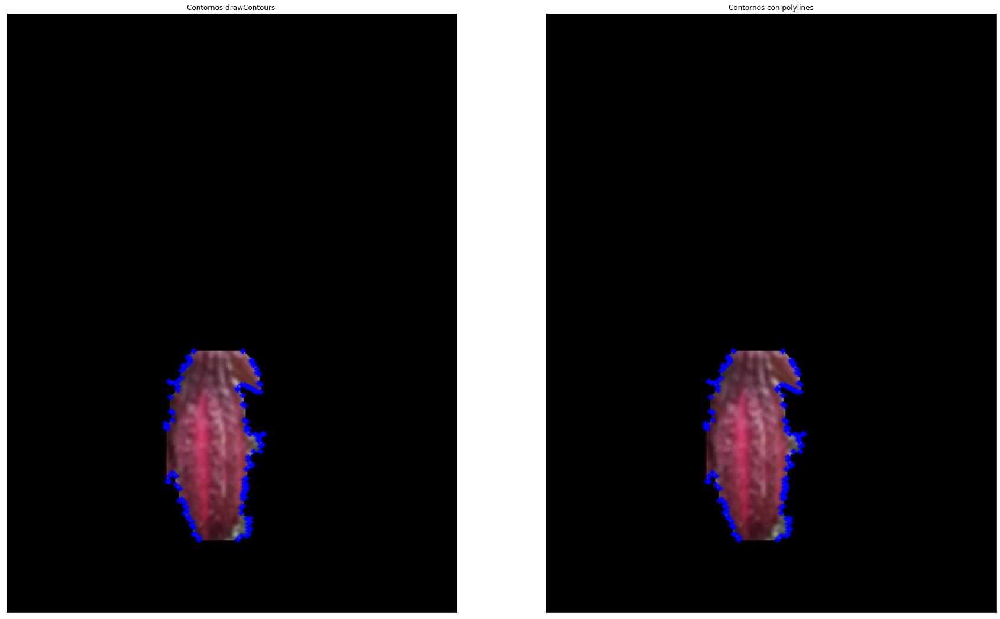

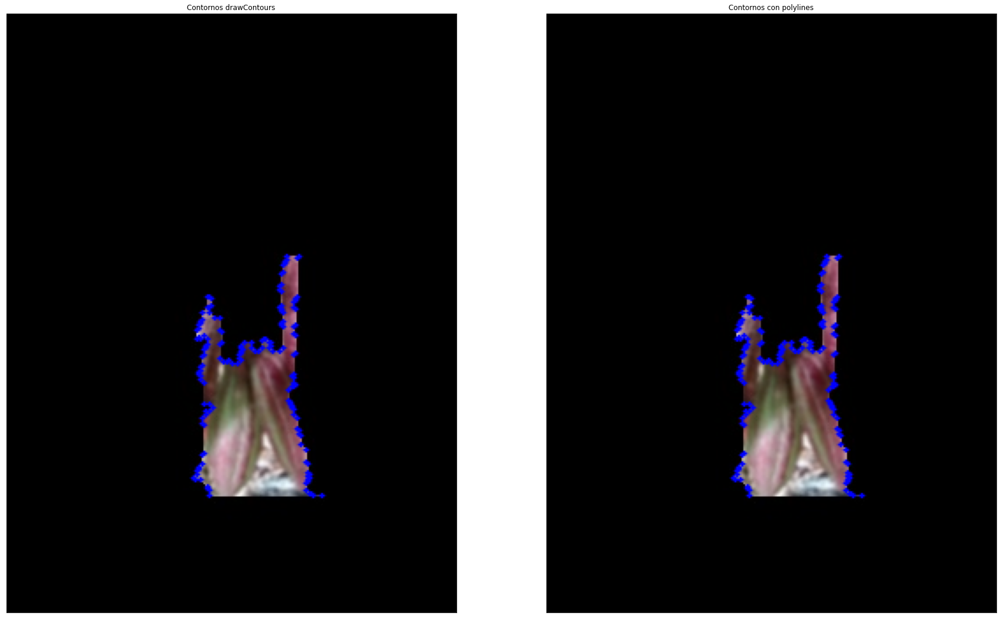

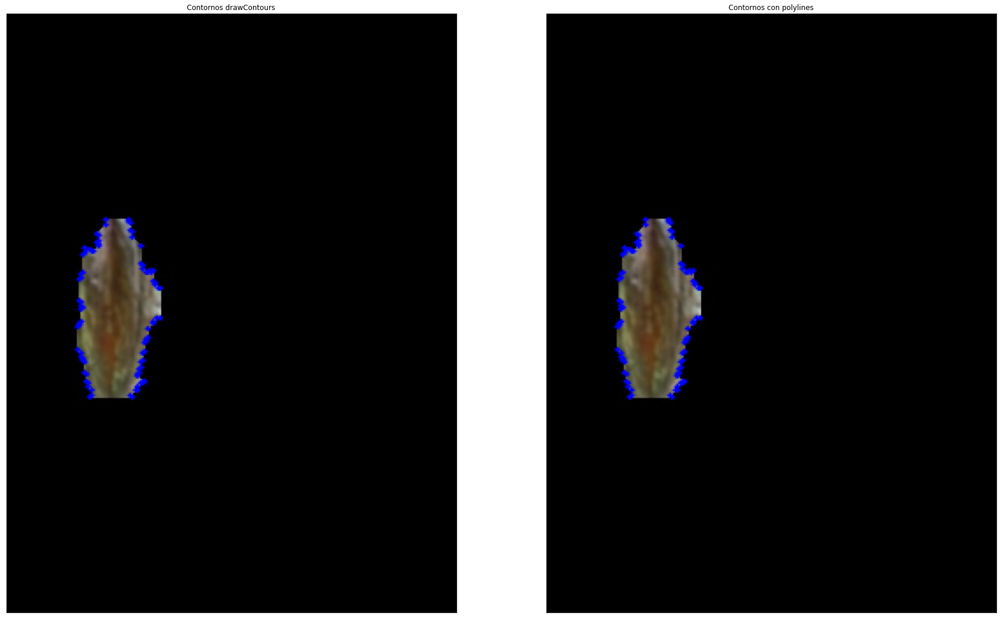

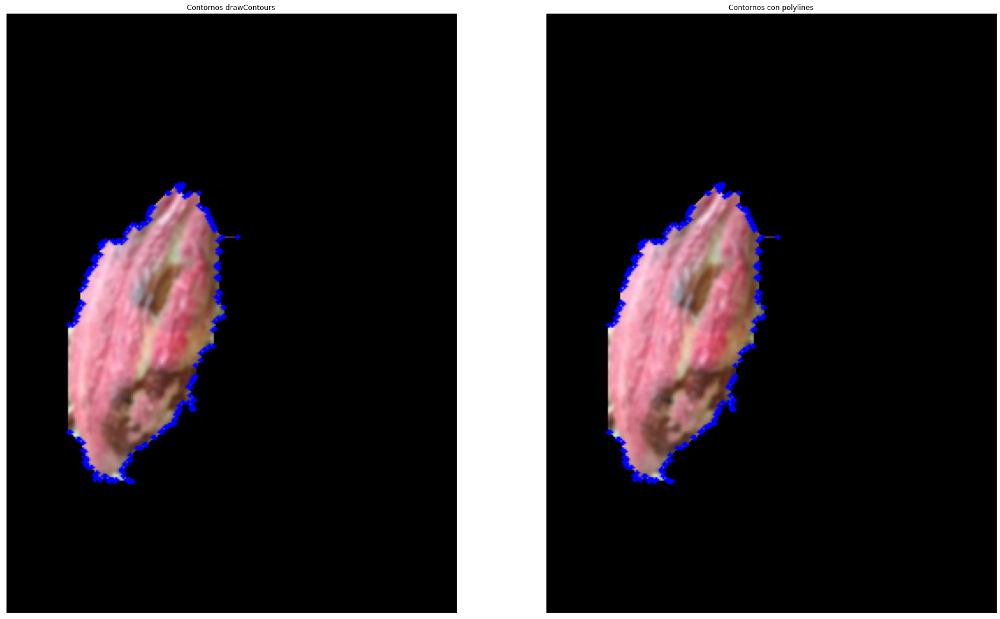

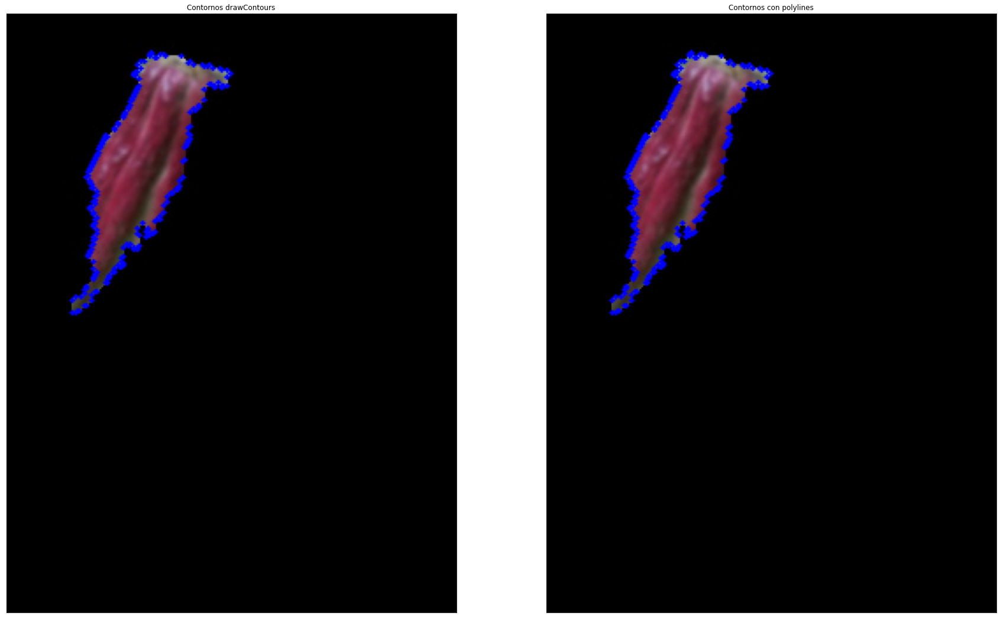

In [47]:
# Zona de verificación

# Se dibujan los contornos
n_total=len(imagenes)


for i in range(n_total):
    plt.figure(figsize=(30, 30))
    plt.subplot(1,2,1),plt.imshow(img_contornos_drawContours[i])
    plt.title('Contornos drawContours'), plt.xticks([]), plt.yticks([])
    
    plt.subplot(1,2,2),plt.imshow(img_contornos_polylines[i])
    plt.title('Contornos con polylines'), plt.xticks([]), plt.yticks([])
    
    plt.show()